In [1]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.6/112.6 GB disk)


# Entrainement


In [ ]:
!yolo task=detect mode=train model=yolo11n.pt data=drive/MyDrive/AIforMeterReading/data.yaml epochs=20 imgsz=640

100% 5.35M/5.35M [00:00<00:00, 223MB/s]
Ultralytics 8.3.42 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=drive/MyDrive/AIforMeterReading/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_c

In [ ]:
!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data=drive/MyDrive/AIforMeterReading/data.yaml imgsz=640

Ultralytics 8.3.42 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs
val: Scanning /content/drive/MyDrive/AIforMeterReading/dataset/valid/labels.cache... 19 images, 0 backgrounds, 2 corrupt: 100% 19/19 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/drive/MyDrive/AIforMeterReading/dataset/valid/images/58d982.jpg: ignoring corrupt image/label: negative label values [   -0.22656    -0.32188]
val: WARNING ⚠️ /content/drive/MyDrive/AIforMeterReading/dataset/valid/images/71f4ed.jpg: ignoring corrupt image/label: negative label values [    -0.1125]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0% 0/2 [00:00<?, ?it/s]WARNING ⚠️ NMS time limit 2.800s exceeded
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 2/2 [00:07<00:00,  3.55s/it]
                   all         17         17      0.949      0.118      0.116   

# Prediction


image 1/1 /content/image.jpg: 480x640 2 Cadran m3s, 43.6ms
Speed: 11.8ms preprocess, 43.6ms inference, 933.6ms postprocess per image at shape (1, 3, 480, 640)


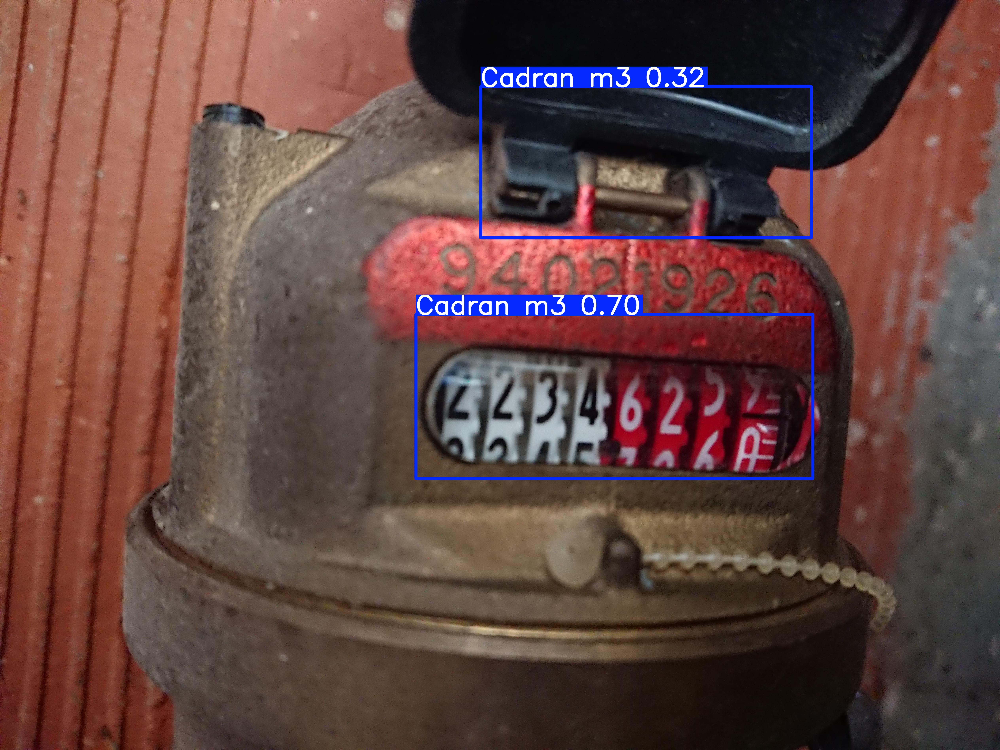

In [2]:
from ultralytics import YOLO

# Load a pre-trained YOLO model (adjust model type as needed)
model = YOLO("best.pt")  # n, s, m, l, x versions available

# Perform object detection on an image
results = model.predict(source="image.jpg")  # Can also use video, directory, URL, etc.

# Display the results
results[0].show()  # Show the first image results

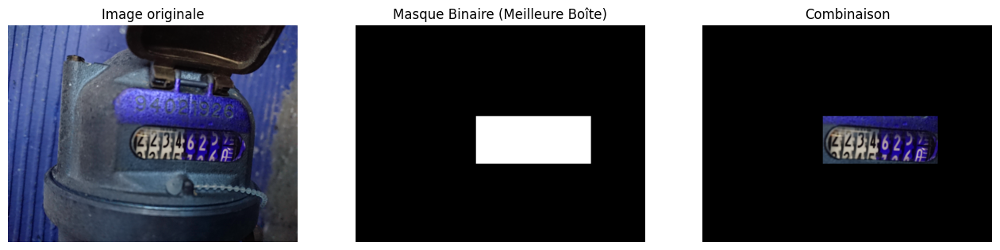

Boîte sélectionnée : 2102, 1589, 4109, 2420


In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image d'origine
image_path = "image.jpg"
original_image = cv2.imread(image_path)
height, width = original_image.shape[:2]  # Dimensions de l'image

# Extraire les boîtes englobantes et les scores de confiance
boxes = results[0].boxes  # Obtenir les boîtes
if len(boxes) > 0:
    xyxy = boxes.xyxy.cpu().numpy()  # Coordonnées (x_min, y_min, x_max, y_max)
    confidences = boxes.conf.cpu().numpy()  # Scores de confiance

    # Trouver la boîte avec le score de confiance le plus élevé
    max_idx = np.argmax(confidences)
    best_box = xyxy[max_idx]  # Coordonnées de la meilleure boîte
    x_min, y_min, x_max, y_max = map(int, best_box)

    # Créer un masque binaire
    mask = np.zeros((height, width), dtype=np.uint8)
    mask[y_min:y_max, x_min:x_max] = 255  # Région détectée en blanc

    masked_image = cv2.bitwise_and(original_image, original_image, mask=mask)

    # Visualiser le masque binaire
    fig = plt.figure(figsize=(16, 8))
    fig.add_subplot(1,3,1), plt.title("Image originale")
    plt.imshow(original_image)
    plt.axis("off")
    fig.add_subplot(1,3,2), plt.title("Masque Binaire (Meilleure Boîte)")
    plt.imshow(mask, cmap="gray")
    plt.axis("off")
    fig.add_subplot(1,3,3), plt.title("Combinaison")
    plt.imshow(masked_image)
    plt.axis("off")
    plt.show()

    print(f"Boîte sélectionnée : {x_min}, {y_min}, {x_max}, {y_max}")
else:
    print("[INFO] Aucune boîte détectée.")